In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 22.0 MB 1.4 MB/s 
     |████████████████████████████████| 102 kB 33.0 MB/s 
     |████████████████████████████████| 690 kB 52.5 MB/s 
     |████████████████████████████████| 62 kB 1.6 MB/s 
     |████████████████████████████████| 9.9 MB 47.6 MB/s 
     |████████████████████████████████| 4.7 MB 57.5 MB/s 
     |████████████████████████████████| 296 kB 71.3 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.4.0-py2.py3-none-any.whl size=315268 sha256=ad0ba0540cc9ae20896d26d12f071e9a4a03a656e3677d52783d2338ebde1cb7
  Stored in directory: /tmp/pip-ephem-wheel-cache-xzfglgz8/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=8fcbef1d5c14a128de3e716134fa18b29c1cb2150b103888230bffb3a7bb180f
  Stored in directory: /root/.cache/pip/whe

In [ ]:
import os
os._exit(00)


In [ ]:
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import io
import seaborn as sns
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_validate

In [ ]:
from google.colab import drive
drive.mount('/content/drive')  

Mounted at /content/drive


In [ ]:
db = pd.read_excel('/content/drive/My Drive/ASE/BaseFInBueno.xlsx')

In [ ]:
profile = ProfileReport(db, title="Analisis-de-Viviendas-CDMX", html={'style': {'full_width': True}})

In [ ]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
db.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320 entries, 0 to 319
Data columns (total 25 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   No. Vivienda                                320 non-null    float64
 1   Tipo                                        320 non-null    object 
 2   CLAVE                                       320 non-null    float64
 3   Precio                                      320 non-null    float64
 4   CLAVE.1                                     320 non-null    float64
 5   Colonia                                     320 non-null    object 
 6   m2                                          320 non-null    float64
 7   CLAVE.2                                     320 non-null    float64
 8   Alcaldia                                    320 non-null    object 
 9   CLAVE.3                                     320 non-null    float64
 10  Indice SHF 201

In [ ]:
db.drop(columns = ['No. Vivienda', 'CLAVE', 
                           'CLAVE.1' ,'CLAVE.2', 'CLAVE.3',
                           'CLAVE.4', 'CLAVE.5', 'CLAVE.6',
                           'Indice SHF 2010 ', 'Indice SHF 2015',
                            'Indice SHF 2020', 'Indice de Seguridad (x 100,000 habitantes)',
                  'Colonia','General'], inplace = True)


In [ ]:
db.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320 entries, 0 to 319
Data columns (total 11 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   Tipo                                       320 non-null    object 
 1   Precio                                     320 non-null    float64
 2   m2                                         320 non-null    float64
 3   Alcaldia                                   320 non-null    object 
 4   Indice SHF 2022                            320 non-null    float64
 5   Materiales de Construcción                 320 non-null    float64
 6   Alquiler de Maquinaria                     320 non-null    float64
 7   Mano De Obra                               320 non-null    float64
 8   % de Población Inmigrante (por Alcaldía)   320 non-null    float64
 9   Población inmigrante por alcaldía          320 non-null    int64  
 10  Indice de Seguridad (Pobla

In [ ]:
set(db.Alcaldia)

{'Azcapotzalco',
 'Benito Juárez',
 'Coyoacán',
 'Cuajimalpa',
 'Cuauhtémoc',
 'Gustavo A. Madero',
 'Iztacoalco',
 'Iztapalapa',
 'Magdalena Contreras',
 'Miguel Hidalgo',
 'Milpa Alta',
 'Tlalpan',
 'Tláhuac',
 'Venustiano Carranza',
 'Xochimilco',
 'Álvaro Obregón '}

In [ ]:
new_cols = []
for col in db.columns:
    new_cols.append(col.strip())

In [ ]:
db.columns = new_cols

In [ ]:
one_hot_encoder_list = ['Tipo', 'Alcaldia']

In [ ]:
ohe = OneHotEncoder(sparse =False)
transformed = ohe.fit_transform(db[['Tipo']])
db['Casa'], db['Deptartamento'] = transformed.T

In [ ]:
ohe = OneHotEncoder(sparse =False)
transformed = ohe.fit_transform(db[['Tipo']])
db['Casa'], db['Deptartamento'] = transformed.T

In [ ]:
string = ''
for alc in db['Alcaldia'].unique():
    string += f'db[\'{alc}\'],'

In [ ]:
ohe = OneHotEncoder(sparse =False)
transformed = ohe.fit_transform(db[['Alcaldia']])
db['Álvaro Obregón '],db['Azcapotzalco'],db['Benito Juárez'],db['Coyoacán'],db['Cuajimalpa'],db['Cuauhtémoc'],db['Gustavo A. Madero'],db['Iztacoalco'],db['Iztapalapa'],db['Magdalena Contreras'],db['Miguel Hidalgo'],db['Milpa Alta'],db['Tláhuac'],db['Tlalpan'],db['Venustiano Carranza'],db['Xochimilco'] = transformed.T

In [ ]:
db.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320 entries, 0 to 319
Data columns (total 29 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Tipo                                      320 non-null    object 
 1   Precio                                    320 non-null    float64
 2   m2                                        320 non-null    float64
 3   Alcaldia                                  320 non-null    object 
 4   Indice SHF 2022                           320 non-null    float64
 5   Materiales de Construcción                320 non-null    float64
 6   Alquiler de Maquinaria                    320 non-null    float64
 7   Mano De Obra                              320 non-null    float64
 8   % de Población Inmigrante (por Alcaldía)  320 non-null    float64
 9   Población inmigrante por alcaldía         320 non-null    int64  
 10  Indice de Seguridad (Población Total) 

In [ ]:
standard_scaler_list = ['Precio','m2','Indice SHF 2022', 'Materiales de Construcción', 
        'Alquiler de Maquinaria', 'Mano De Obra', '% de Población Inmigrante (por Alcaldía)', 
        'Población inmigrante por alcaldía',
        'Indice de Seguridad (Población Total)']


In [ ]:
scaler = StandardScaler()
scaler.fit(db[standard_scaler_list]) # Fit scaler to data
db[standard_scaler_list] = scaler.transform(db[standard_scaler_list]) # Use scaler to transform data

In [ ]:
db

,Tipo,Precio,m2,Alcaldia,Indice SHF 2022,Materiales de Construcción,Alquiler de Maquinaria,Mano De Obra,% de Población Inmigrante (por Alcaldía),Población inmigrante por alcaldía,...,Gustavo A. Madero,Iztacoalco,Iztapalapa,Magdalena Contreras,Miguel Hidalgo,Milpa Alta,Tláhuac,Tlalpan,Venustiano Carranza,Xochimilco
0,Casa,1.065420,0.949122,Álvaro Obregón,-0.136928,2.842171e-14,-1.421085e-14,0.0,-0.645549,-0.014215,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,Casa,2.249367,4.527476,Álvaro Obregón,-0.136928,2.842171e-14,-1.421085e-14,0.0,-0.645549,-0.014215,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,Departamento,-0.242558,-0.505732,Álvaro Obregón,-0.136928,2.842171e-14,-1.421085e-14,0.0,-0.645549,-0.014215,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,Departamento,-0.062148,-0.094258,Álvaro Obregón,-0.136928,2.842171e-14,-1.421085e-14,0.0,-0.645549,-0.014215,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,Departamento,0.095599,0.530301,Álvaro Obregón,-0.136928,2.842171e-14,-1.421085e-14,0.0,-0.645549,-0.014215,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,Casa,-0.698073,0.229043,Xochimilco,-0.136928,2.842171e-14,-1.421085e-14,0.0,2.122407,1.436523,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
316,Departamento,-0.650738,-0.784946,Xochimilco,-0.136928,2.842171e-14,-1.421085e-14,0.0,2.122407,1.436523,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
317,Departamento,-0.673957,-0.505732,Xochimilco,-0.136928,2.842171e-14,-1.421085e-14,0.0,2.122407,1.436523,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
318,Casa,-0.701894,-0.593905,Xochimilco,-0.136928,2.842171e-14,-1.421085e-14,0.0,2.122407,1.436523,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
db.drop(columns = ['Tipo', 'Alcaldia'], inplace = True)

In [ ]:
print(db.describe())

             Precio            m2  Indice SHF 2022  \
count  3.200000e+02  3.200000e+02     3.200000e+02   
mean   4.440892e-17  2.220446e-17     2.976508e-14   
std    1.001566e+00  1.001566e+00     1.001566e+00   
min   -7.239736e-01 -9.612921e-01    -1.369277e-01   
25%   -5.360080e-01 -6.673822e-01    -1.369277e-01   
50%   -3.446033e-01 -3.514290e-01    -1.369277e-01   
75%    9.134260e-02  3.172161e-01    -1.369277e-01   
max    6.703260e+00  7.400445e+00     7.613595e+00   

       Materiales de Construcción  Alquiler de Maquinaria  Mano De Obra  \
count                3.200000e+02            3.200000e+02         320.0   
mean                 2.842171e-14           -1.421085e-14           0.0   
std                  0.000000e+00            0.000000e+00           0.0   
min                  2.842171e-14           -1.421085e-14           0.0   
25%                  2.842171e-14           -1.421085e-14           0.0   
50%                  2.842171e-14           -1.421085e-14      

In [ ]:
db.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320 entries, 0 to 319
Data columns (total 27 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Precio                                    320 non-null    float64
 1   m2                                        320 non-null    float64
 2   Indice SHF 2022                           320 non-null    float64
 3   Materiales de Construcción                320 non-null    float64
 4   Alquiler de Maquinaria                    320 non-null    float64
 5   Mano De Obra                              320 non-null    float64
 6   % de Población Inmigrante (por Alcaldía)  320 non-null    float64
 7   Población inmigrante por alcaldía         320 non-null    float64
 8   Indice de Seguridad (Población Total)     320 non-null    float64
 9   Casa                                      320 non-null    float64
 10  Deptartamento                         

In [ ]:
db.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
db.drop(columns = ['Materiales de Construcción','Alquiler de Maquinaria','Mano De Obra'], inplace = True)

In [ ]:
db.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#scaler = MinMaxScaler()
#scaler.fit(db[min_max_scaler_list]) # Fit scaler to data
#db[min_max_scaler_list] = scaler.transform(db[min_max_scaler_list])

In [ ]:
db

,Precio,m2,Indice SHF 2022,% de Población Inmigrante (por Alcaldía),Población inmigrante por alcaldía,Indice de Seguridad (Población Total),Casa,Deptartamento,Álvaro Obregón,Azcapotzalco,...,Gustavo A. Madero,Iztacoalco,Iztapalapa,Magdalena Contreras,Miguel Hidalgo,Milpa Alta,Tláhuac,Tlalpan,Venustiano Carranza,Xochimilco
0,1.065420,0.949122,-0.136928,-0.645549,-0.014215,-0.500111,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,2.249367,4.527476,-0.136928,-0.645549,-0.014215,-0.500111,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,-0.242558,-0.505732,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.062148,-0.094258,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.095599,0.530301,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,-0.698073,0.229043,-0.136928,2.122407,1.436523,-0.678025,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
316,-0.650738,-0.784946,-0.136928,2.122407,1.436523,-0.678025,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
317,-0.673957,-0.505732,-0.136928,2.122407,1.436523,-0.678025,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
318,-0.701894,-0.593905,-0.136928,2.122407,1.436523,-0.678025,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


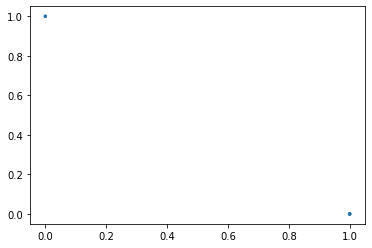

In [ ]:
import matplotlib.pyplot as plt
plt.scatter(db.Casa, db.Deptartamento, s=db.Precio)
#plt.scatter(df.preTestScore, df.postTestScore, s=300, c=df.female)

In [ ]:
X = db.iloc[:, :-1].values
y = db.iloc[:, -1].values

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 0)



In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [ ]:
from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(random_state = 0)
classifier.fit(X_train, y_train)

LogisticRegression(random_state=0)

In [ ]:
y_pred = classifier.predict(X_test)
print(np.concatenate((y_pred.reshape(len(y_pred),1), y_test.reshape(len(y_test),1)),1))

[[0. 0.]
 [0. 0.]
 [1. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [1. 1.]
 [1. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [1. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 1.]
 [1. 1.]
 [0. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [1. 1.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]
 [0. 0.]]


In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score
cm = confusion_matrix(y_test, y_pred)
print(cm)
accuracy_score(y_test, y_pred)

[[72  0]
 [ 2  6]]


0.975

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR

# YOUR CODE HERE
#model_LR = LinearRegression()
model_svr = SVR(C=1.0, epsilon=0.2)
#model = LinearRegression()

X = db.drop(columns = ['Precio'])
y = db['Precio']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)



model_svr.fit(X, y)
y_predict= model_svr.predict(X_test)
y_predict

array([-0.4741578 , -0.48972034, -0.60382394,  1.86466186, -0.15197952,
       -0.22388366,  0.85351218, -0.60218834, -0.38145381, -0.33740324,
       -0.05264453,  0.12619004, -0.25656665, -0.42216957, -0.3537892 ,
        1.35419421,  0.98384113, -0.07947751, -0.21387506,  0.60316547,
       -0.14132798,  1.01634522, -0.2581414 , -0.53500873,  0.41347388,
        2.80576108, -0.51356775,  0.61011353, -0.09672382,  0.66810271,
       -0.35000705, -0.36453214, -0.46784838, -0.35152408, -0.5204689 ,
        0.24200532, -0.15606545, -0.43766026, -0.42326322,  0.46051016,
       -0.33558144, -0.05173011, -0.37846425, -0.47629815, -0.25882698,
       -0.06915236,  0.28662589,  0.66810271, -0.1941435 , -0.36389379,
       -0.17853462,  0.06473674, -0.44291716, -0.2045925 ,  0.3184023 ,
        0.05144558, -0.43334909, -0.32548561, -0.62743759, -0.20654404,
        0.36716876, -0.39173685, -0.44511477, -0.33214545, -0.49511204,
       -0.48270521, -0.522489  , -0.48430211, -0.47924237,  0.49

In [ ]:
y_test

167   -0.674417
230   -0.484986
25    -0.593232
63     1.448793
9     -0.011407
         ...   
108   -0.310213
269   -0.344040
66    -0.310213
197    0.727150
18     1.911096
Name: Precio, Length: 106, dtype: float64

In [ ]:
model.intercept_

-0.019954650908806416

In [ ]:

from sklearn.svm import SVR

# YOUR CODE HERE
model_LR = LinearRegression()
model_svr = SVR(C=1.0, epsilon=0.2)

# Define X and y
X = db.drop(columns = ['Precio'])
y = db['Precio']

# Train the model on the data
# YOUR CODE HERE

# 5-Fold Cross validate model
cv_results = cross_validate(model_svr, X, y, cv=10)

In [ ]:
cv_results['test_score'].mean()

-2.648800396812768

In [ ]:
X

,m2,Indice SHF 2022,% de Población Inmigrante (por Alcaldía),Población inmigrante por alcaldía,Indice de Seguridad (Población Total),Casa,Deptartamento,Álvaro Obregón,Azcapotzalco,Benito Juárez,...,Gustavo A. Madero,Iztacoalco,Iztapalapa,Magdalena Contreras,Miguel Hidalgo,Milpa Alta,Tláhuac,Tlalpan,Venustiano Carranza,Xochimilco
0,0.949122,-0.136928,-0.645549,-0.014215,-0.500111,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,4.527476,-0.136928,-0.645549,-0.014215,-0.500111,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,-0.505732,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,-0.094258,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.530301,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,0.229043,-0.136928,2.122407,1.436523,-0.678025,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
316,-0.784946,-0.136928,2.122407,1.436523,-0.678025,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
317,-0.505732,-0.136928,2.122407,1.436523,-0.678025,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
318,-0.593905,-0.136928,2.122407,1.436523,-0.678025,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
cv_results

{'fit_time': array([0.00935602, 0.00382495, 0.00334549, 0.00340509, 0.00358558,
        0.00351667, 0.0044353 , 0.0034287 , 0.00344276, 0.00340772]),
 'score_time': array([0.00210118, 0.00164413, 0.00154114, 0.00153041, 0.00157332,
        0.00152302, 0.00184846, 0.00144291, 0.0014801 , 0.00144053]),
 'test_score': array([  0.57334291,   0.52467441,   0.31746716,   0.13807701,
         -0.25321865,   0.17204429,   0.20123335,  -4.53558074,
          0.78809026, -24.41413397])}

In [ ]:
X_test = X_test.reset_index().drop(columns = ['index'])

In [ ]:
X_test.iloc[1].tolist()

[0.2290430777633478,
 -0.13692773279173825,
 -0.9898253830235926,
 -1.7958227339039576,
 -0.7721171986628983,
 1.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0]

In [ ]:
X_test

,m2,Indice SHF 2022,% de Población Inmigrante (por Alcaldía),Población inmigrante por alcaldía,Indice de Seguridad (Población Total),Casa,Deptartamento,Álvaro Obregón,Azcapotzalco,Benito Juárez,...,Gustavo A. Madero,Iztacoalco,Iztapalapa,Magdalena Contreras,Miguel Hidalgo,Milpa Alta,Tláhuac,Tlalpan,Venustiano Carranza,Xochimilco
0,-0.858424,-0.136928,-1.104881,1.530008,-0.679538,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.229043,-0.136928,-0.989825,-1.795823,-0.772117,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,-0.652687,-0.136928,-0.022655,-0.295727,0.038946,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3.440009,-0.136928,-0.143042,0.267018,0.055978,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,-0.211822,-0.136928,-0.645549,-0.014215,-0.500111,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101,-0.704121,-0.136928,0.562431,0.562107,3.360100,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
102,-0.432254,-0.136928,-0.360956,0.340248,-0.488461,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
103,0.816863,-0.136928,-0.143042,0.267018,0.055978,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
104,0.838906,-0.136928,-0.859104,-1.512419,-0.622359,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
db2 = pd.read_excel('/content/drive/My Drive/ASE/BaseFInBueno.xlsx')

In [ ]:
db2.info

<bound method DataFrame.info of      No. Vivienda         Tipo   CLAVE     Precio   CLAVE.1  \
0             1.0          Casa    1.0  16500000.0      9.0   
1             2.0          Casa    1.0  27000000.0     13.0   
2             3.0  Departamento    2.0   4900000.0      4.0   
3             4.0  Departamento    2.0   6500000.0      5.0   
4             5.0  Departamento    2.0   7899000.0      6.0   
..            ...           ...    ...         ...      ...   
315         316.0          Casa    1.0    860200.0      1.0   
316         317.0  Departamento    2.0   1280000.0      2.0   
317         318.0  Departamento    2.0   1074079.0      2.0   
318         319.0          Casa    1.0    826312.0      1.0   
319         320.0  Departamento    2.0   3330000.0      3.0   

                   Colonia    m2   CLAVE.2         Alcaldia  CLAVE.3  ...  \
0              Las Aguilas  298.0      6.0  Álvaro Obregón       1.0  ...   
1    Jardines del Pedregal  785.0     15.0  Álvaro Obregó

In [ ]:
agg = db.groupby('Alcaldia').agg([np.mean, np.var])
agg

KeyError: ignored

In [ ]:
db2 = db2[['CLAVE.3','Precio ','% de Población Inmigrante (por Alcaldía) ']]

In [ ]:
agg = db.groupby('CLAVE.3').agg([np.mean, np.var])
agg

KeyError: ignored

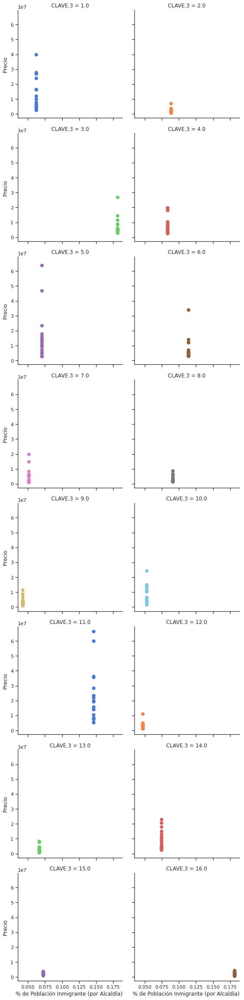

In [ ]:
sns.set(style="ticks")
sns.lmplot(x= "% de Población Inmigrante (por Alcaldía) ", y="Precio ", col="CLAVE.3", hue="CLAVE.3", data=db2,
               col_wrap=2, ci=None, palette="muted", height=4,
               scatter_kws={"s": 50, "alpha": 1});

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


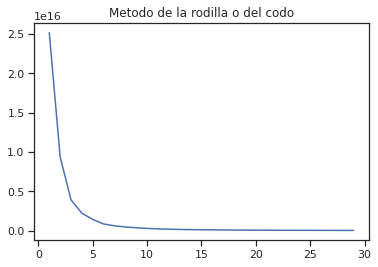

In [ ]:
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
!pip install kneed

data_clust = db.loc[:, db.columns != "Precio "]

wcss = []

for i in range(1,30):
  kmeans = KMeans(n_clusters = i, init = "k-means++", max_iter = 300,
                  n_init = 10, random_state = 2022)
  kmeans.fit(data_clust)
  wcss.append(kmeans.inertia_)

plt.plot(range(1,30), wcss)
plt.title("Metodo de la rodilla o del codo")
#plt.xlabel("Numero de grupos (k)")
#plt.ylabel("WCSS")
plt.show()

In [ ]:
from sklearn.decomposition import PCA
X = StandardScaler().fit_transform(data_clust)
pca = PCA(n_components = 2)
principalComponents = pca.fit_transform(X)
principalDf = pd.DataFrame(data=principalComponents, columns=["CP1","CP2"])
principalDf["labels"] = kmeans.labels_
principalDf

,CP1,CP2,labels
0,2.263662,1.541081,10
1,3.442356,3.679269,1
2,0.002298,-0.668551,18
3,0.143866,-0.401421,0
4,0.342933,-0.051709,16
...,...,...,...
315,-0.715299,1.330798,15
316,-2.666701,-0.034552,26
317,-2.590475,0.076770,15
318,-0.949807,0.967991,15


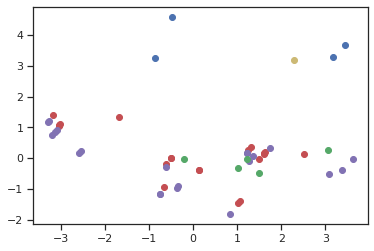

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(1,1,1)

cluster_0 = principalDf[principalDf["labels"] == 0]
cluster_1 = principalDf[principalDf["labels"] == 1]
cluster_2 = principalDf[principalDf["labels"] == 2]
cluster_3 = principalDf[principalDf["labels"] == 3]
cluster_4 = principalDf[principalDf["labels"] == 4]

x_0 = cluster_0["CP1"]
y_0 = cluster_0["CP2"]

x_1 = cluster_1["CP1"]
y_1 = cluster_1["CP2"]

x_2 = cluster_2["CP1"]
y_2 = cluster_2["CP2"]

x_3 = cluster_3["CP1"]
y_3 = cluster_3["CP2"]

x_4 = cluster_4["CP1"]
y_4 = cluster_4["CP2"]


ax.scatter(x_0, y_0, c='r', marker='o')
ax.scatter(x_1, y_1, c='b', marker='o')
ax.scatter(x_2, y_2, c='y', marker='o')
ax.scatter(x_3, y_3, c='m', marker='o')
ax.scatter(x_4, y_4, c='g', marker='o')

plt.show()

In [ ]:
#cambiar al indice de seguridad 
sns.set(style="ticks")
sns.lmplot(x="Precio ", y="m2 ", col="CLAVE.3", hue="CLAVE.3", data=db2,
               col_wrap=2, ci=None, palette="muted", height=4,
               scatter_kws={"s": 50, "alpha": 1});